In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import tensorflow as tf
import os.path
from os import environ
import dask.dataframe as ddf
import cudf
import cupy as cp


2022-12-19 09:53:41.990835: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
/usr/local/miniconda3/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
from feather_io import FeatherReader
data_reader = FeatherReader(environ.get("TEST_DATA", "resolution-test"))
test_dataset = data_reader.as_dask_dataframe()

In [3]:
import preprocessing_utils
default_input_model = "/workarea/cloud-storage/anderlinil/models/resolution"
input_model = os.path.dirname(environ['INPUT_MODEL']) if 'INPUT_MODEL' in environ else default_input_model

resolution_model = tf.keras.models.load_model(input_model)
tX = preprocessing_utils.load_from_pickle("RESOLUTION_PREPROCESSING_X", os.path.join(input_model, "tX.pkl"))
tY = preprocessing_utils.load_from_pickle("RESOLUTION_PREPROCESSING_Y", os.path.join(input_model, "tY.pkl"))

2022-12-19 09:53:46.095435: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [4]:
tX

ColumnTransformer(transformers=[('features',
                                 QuantileTransformer(output_distribution='normal'),
                                 array([0, 1, 2, 3, 4, 5])),
                                ('flags', 'passthrough',
                                 array([ 6,  7,  8,  9, 10, 11]))])

In [5]:
from validation_utils import invert_column_transformer

def process_batch(batch, preprocessorX, preprocessorY, features, labels):
    pX = batch[features].values.astype(np.float32)
    pY = batch[labels].values.astype(np.float32)
    
    batch[features] = invert_column_transformer(preprocessorX, pX)
    batch[labels] = preprocessorY.inverse_transform(pY)

    batch_size = pX.shape[0]
    rX = np.random.normal(0., 1., [batch_size, 128]).astype(np.float32)
    
    pY_hat = resolution_model.predict((pX, rX), batch_size=len(pX), verbose=False)
    batch[[f'predicted_{y}' for y in labels]] = preprocessorY.inverse_transform(pY_hat)
    
    return batch

from functools import partial
my_process_batch = partial(process_batch, 
                        features=data_reader.features, 
                        labels=data_reader.labels, 
                        preprocessorX=tX,
                        preprocessorY=tY,
                       )

## You may need to install dask-cudf
#mamba install -n base dask-cudf -y -c rapidsai -c conda-forge -c nvidia/label/cuda-11.7.0

cdf = (
    ddf
    .map_partitions(my_process_batch, test_dataset)
    .map_partitions(cudf.DataFrame.from_pandas)
)

cdf

INFO:tensorflow:Assets written to: ram://91ad8d0f-f376-4572-9a97-81539d1b9ef7/assets


,true_x_ClosestToBeam,true_y_ClosestToBeam,true_z_ClosestToBeam,true_tx_ClosestToBeam,true_ty_ClosestToBeam,mc_log10_p,mc_is_e,mc_is_mu,mc_is_h,long,upstream,downstream,dx,dy,dz,dtx,dty,dp,chi2PerDoF,nDoF_f,ghostProb,predicted_dx,predicted_dy,predicted_dz,predicted_dtx,predicted_dty,predicted_dp,predicted_chi2PerDoF,predicted_nDoF_f,predicted_ghostProb
npartitions=2,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32
,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...


In [6]:
def compute_momentum(df):
    df['mc_p'] = 10**df['mc_log10_p']
    df['p_GeV'] = df.mc_p/1e3
    df['mc_tx'] = df['true_tx_ClosestToBeam']
    df['mc_ty'] = df['true_ty_ClosestToBeam']
    df['mc_pz'] = (df.mc_p**2 / (1 + df.mc_tx**2 + df.mc_ty**2))**0.5
    df['mc_px'] = df.mc_pz * df.mc_tx
    df['mc_py'] = df.mc_pz * df.mc_ty
    df['mc_pt'] = (df.mc_px**2 + df.mc_py**2)**0.5
    return df

def compute_eta(df):    
    mc_theta = cp.arcsin(df.mc_pt/df.mc_p)
    df['mc_eta'] = -cp.log(cp.tan(mc_theta/2))
    return df

def compute_phi(df):
    df['mc_phi'] = cp.arctan2(df.mc_py, df.mc_px)
    return df

def compute_p_rel_err(df):
    df['dp_rel'] = df['dp']/df['mc_p']
    df['predicted_dp_rel'] = df['predicted_dp']/df['mc_p']
    return df

ccdf = (
    cdf
    .map_partitions(compute_momentum)
    .map_partitions(compute_eta)
    .map_partitions(compute_phi)
    .map_partitions(compute_p_rel_err)
)

In [7]:
binning_schemes = dict(
    dx=cp.linspace(-10, 10, 41),
    dy=cp.linspace(-10, 10, 41),
    dz=cp.linspace(-200, 200, 41),
    dtx=cp.linspace(-0.05, 0.05, 41),
    dty=cp.linspace(-0.05, 0.05, 41),
    dp_rel=cp.linspace(-0.5, 0.5, 41),
    chi2PerDoF=cp.linspace(0, 4, 41),
    nDoF_f=cp.linspace(10, 40, 31),
    ghostProb=cp.linspace(0, 0.4, 41),
)

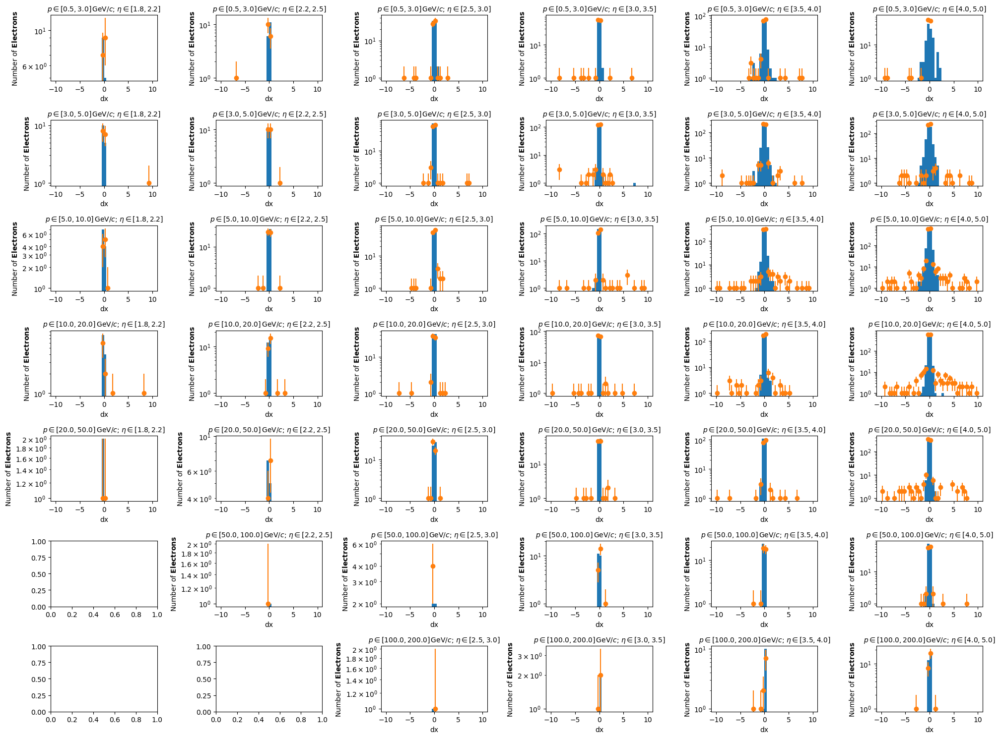

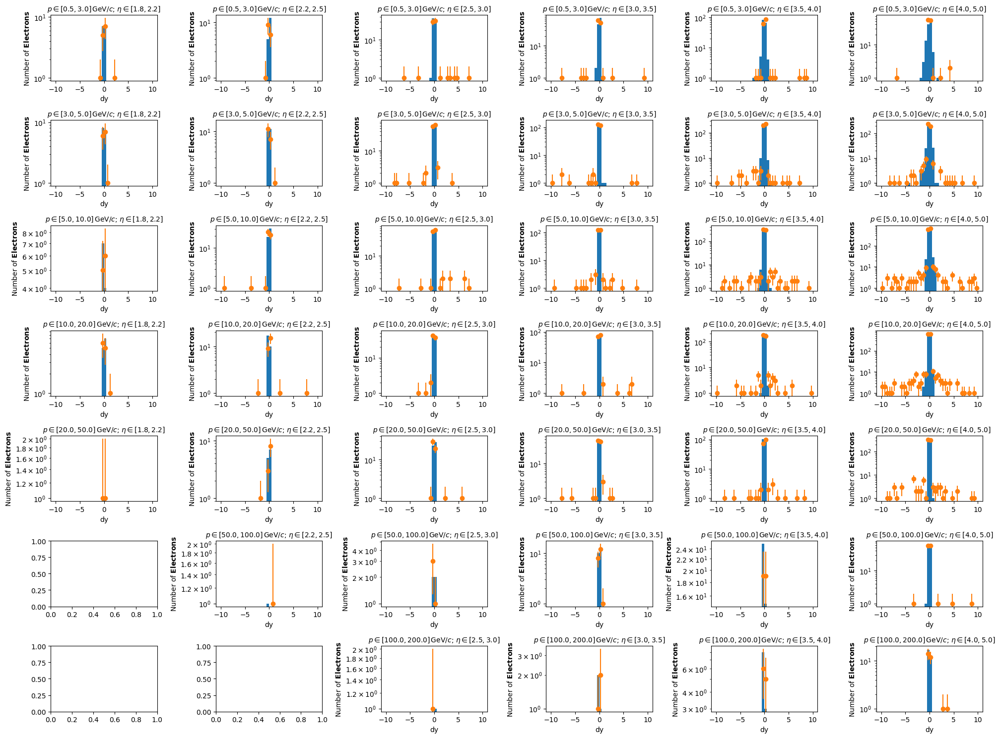

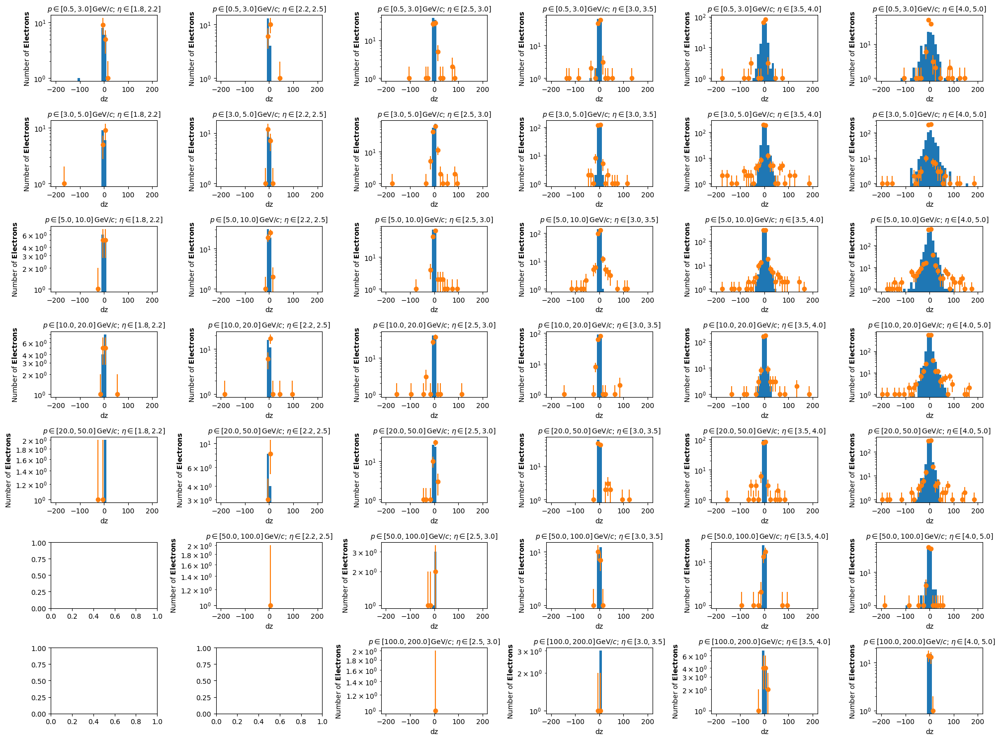

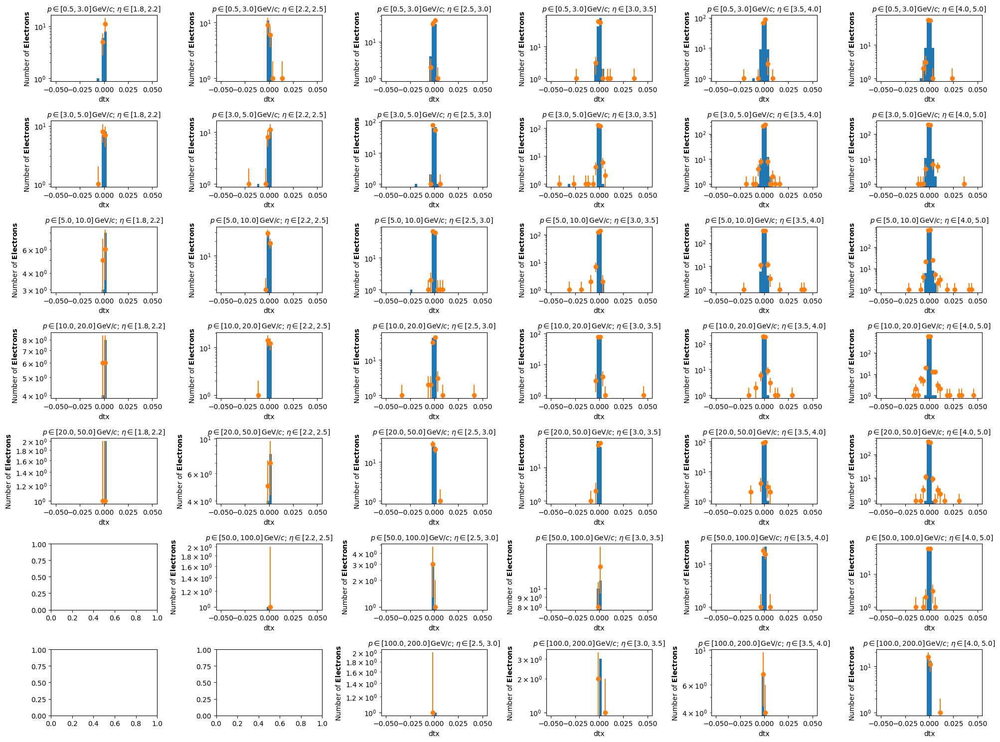

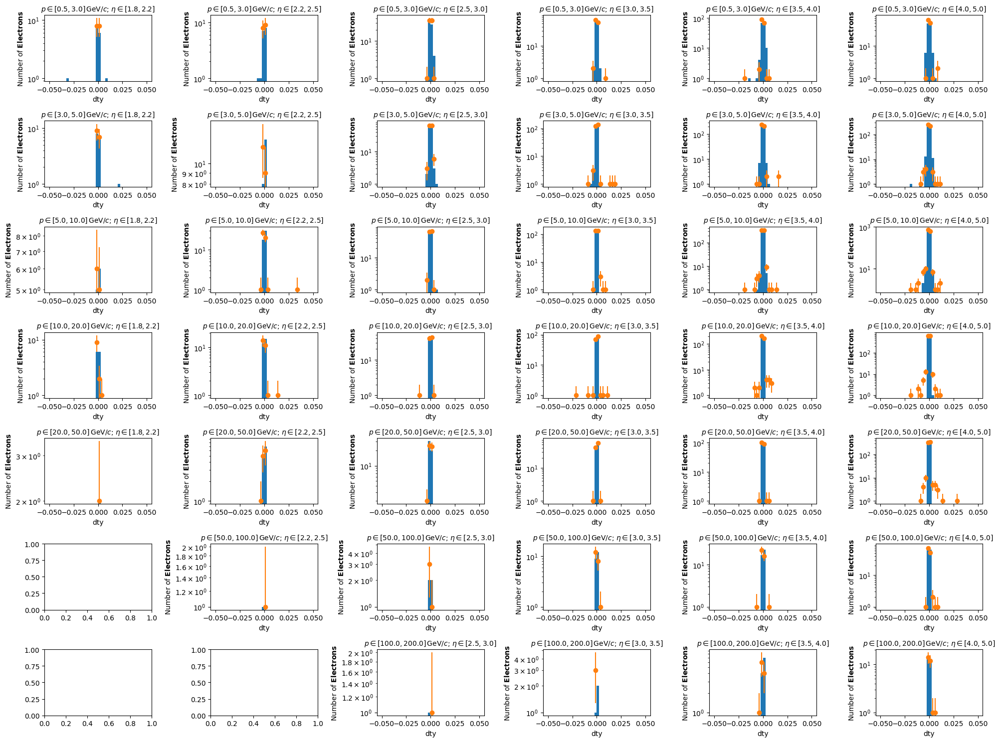

...

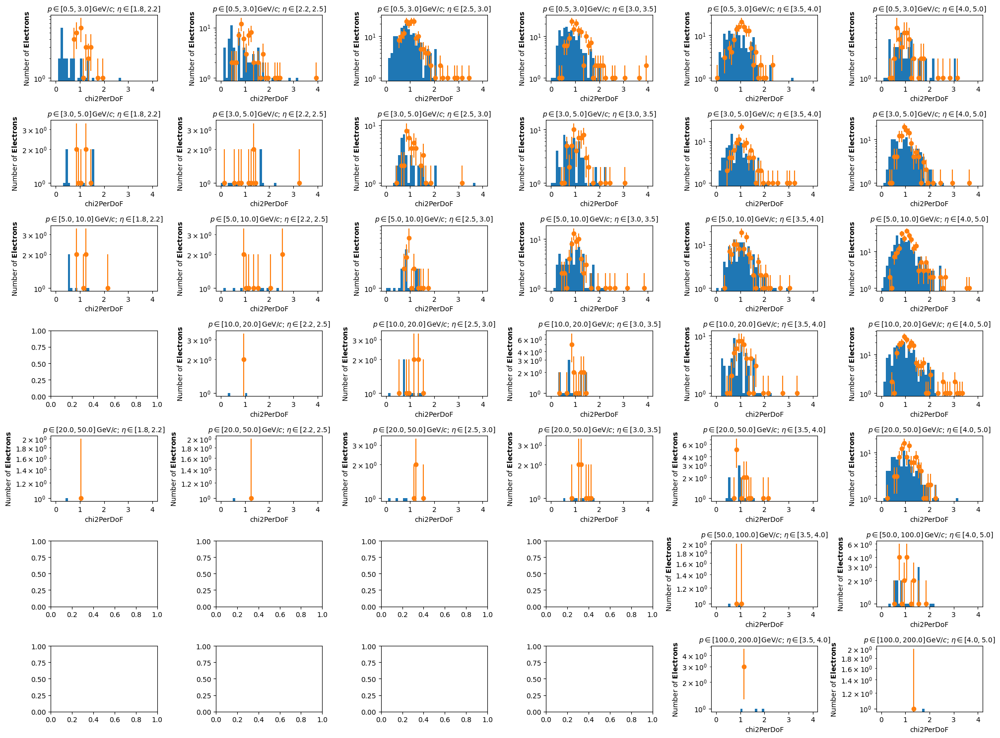

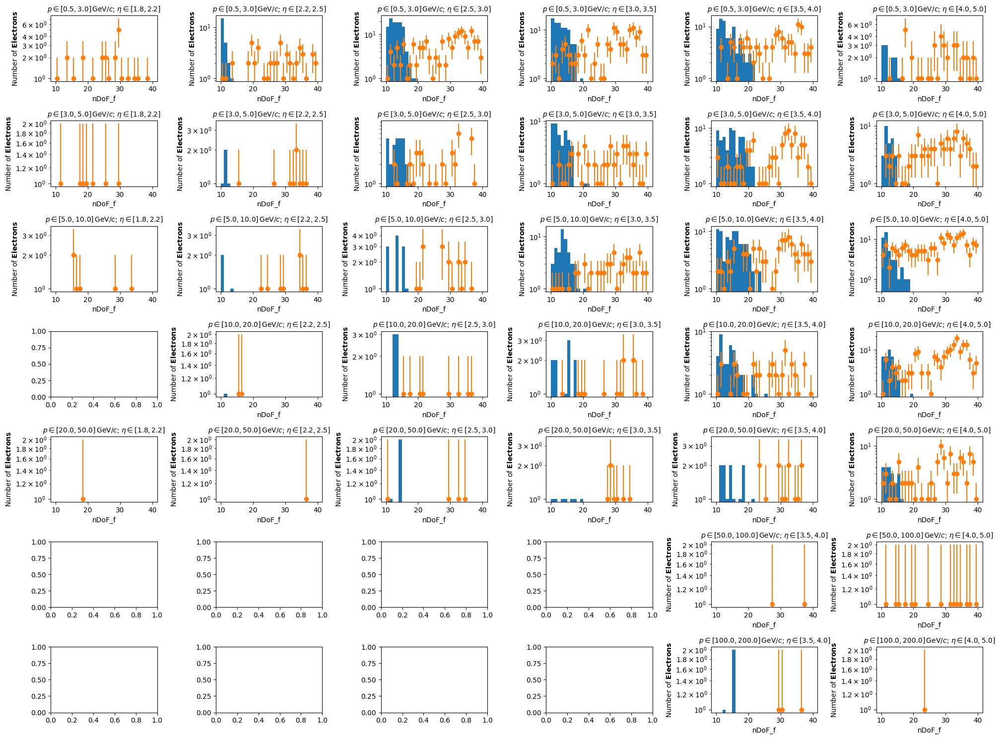

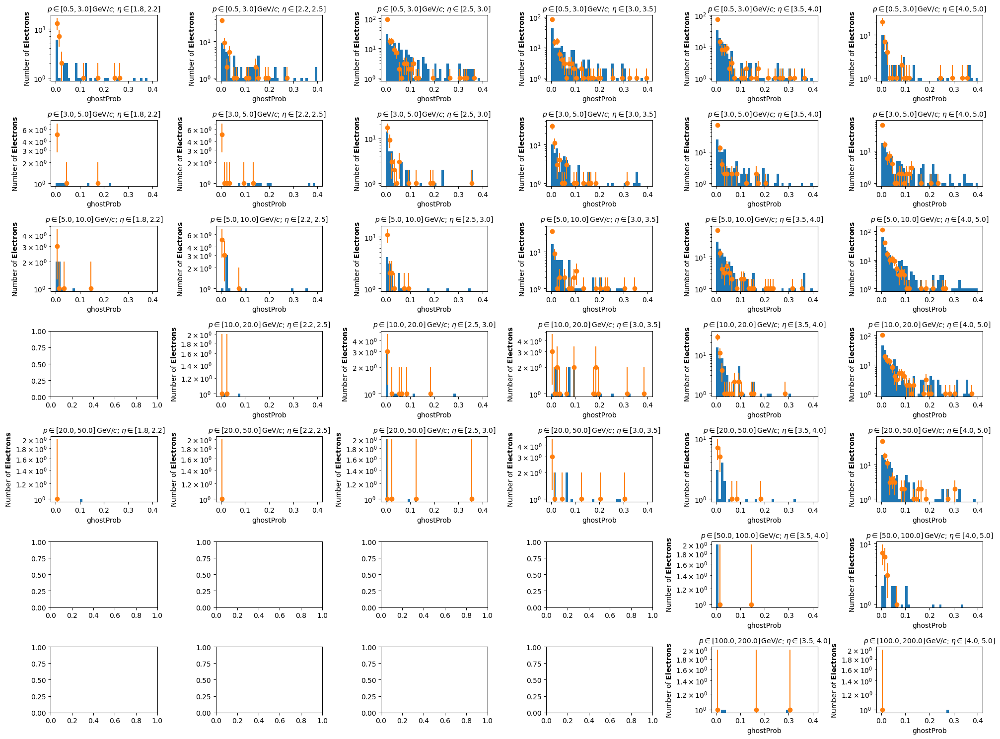

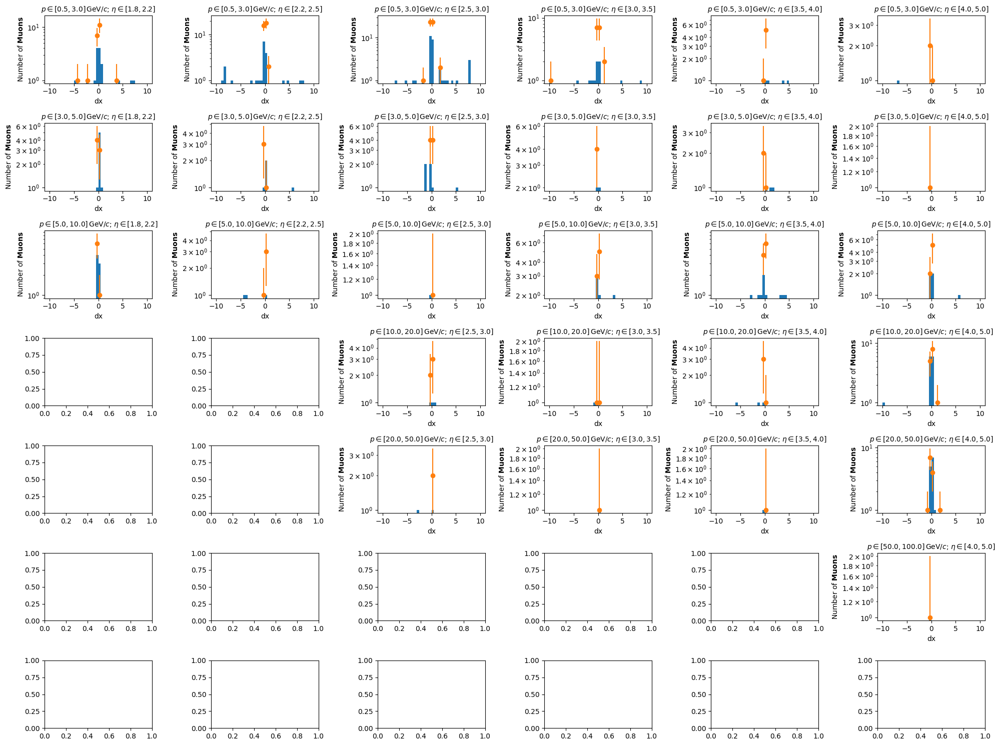

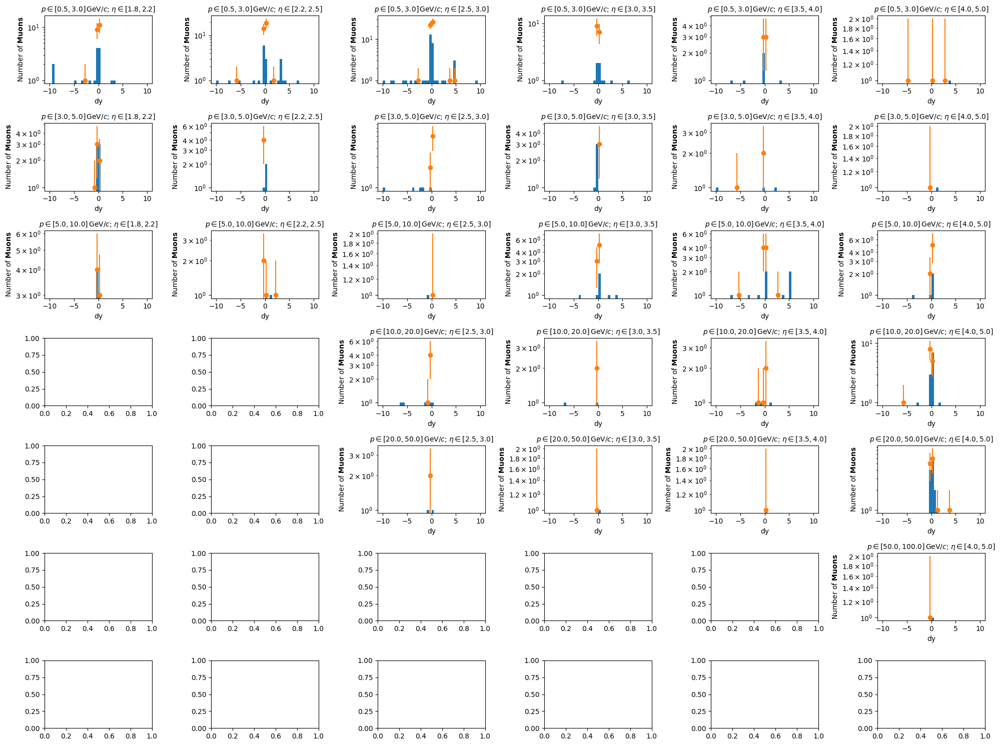

/tmp/ipykernel_27211/3998366271.py:50: RuntimeWarning: ks_2samp: Exact calculation unsuccessful. Switching to method=asymp.
  *ks_2samp(bin_df[label].values.get(), bin_df[f"predicted_{label}"].values.get())])
/tmp/ipykernel_27211/3998366271.py:50: RuntimeWarning: ks_2samp: Exact calculation unsuccessful. Switching to method=asymp.
  *ks_2samp(bin_df[label].values.get(), bin_df[f"predicted_{label}"].values.get())])


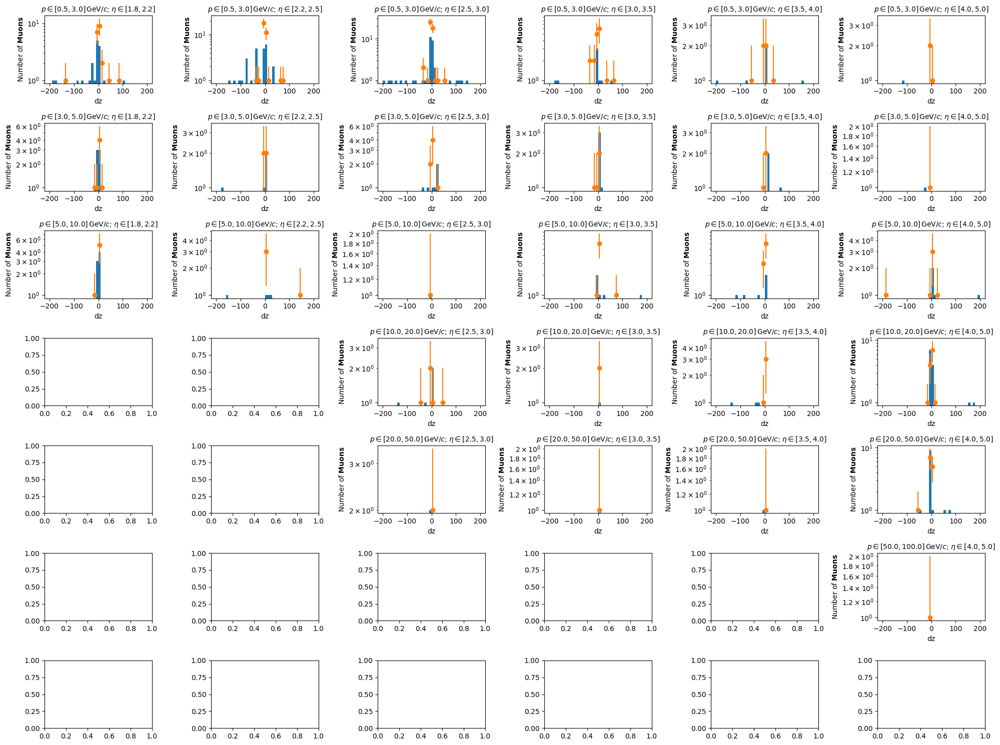

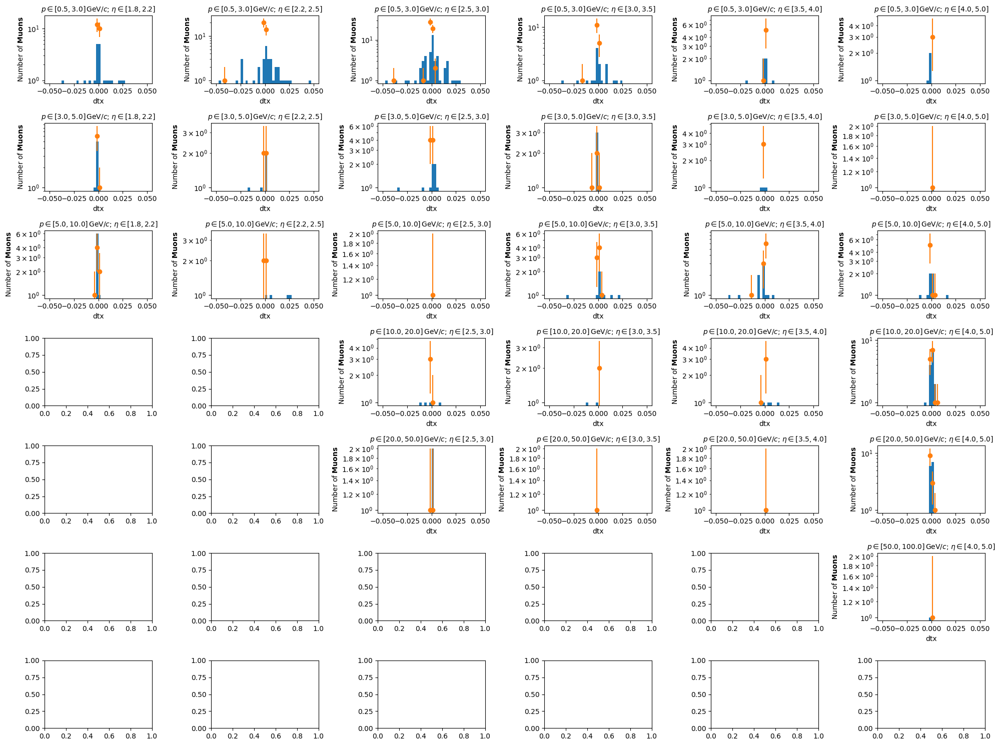

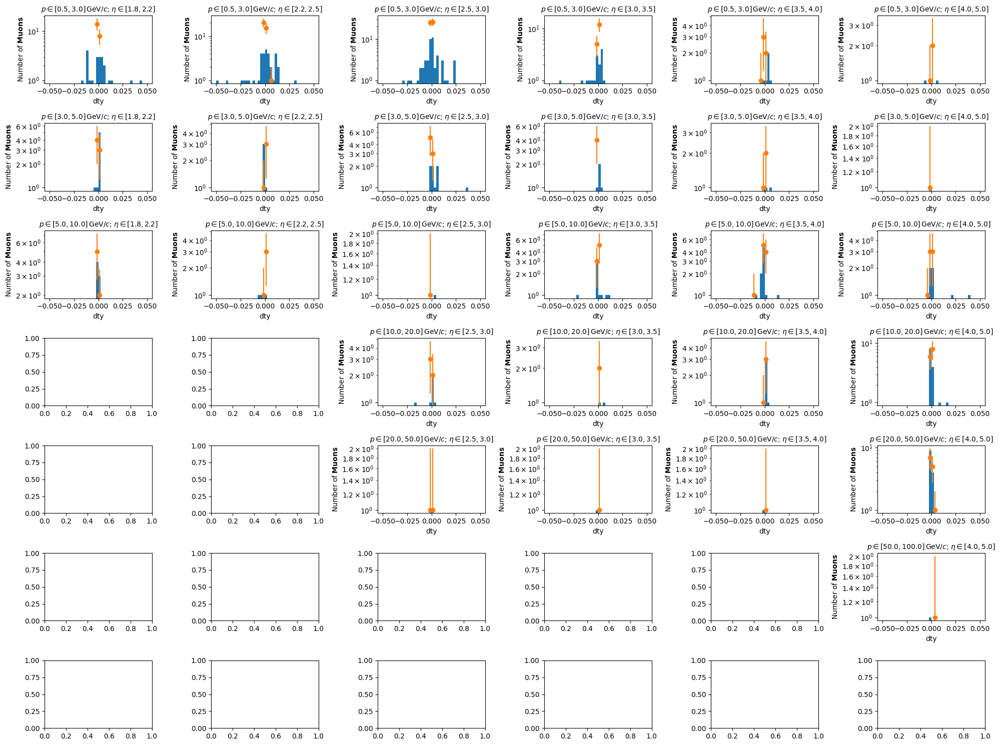

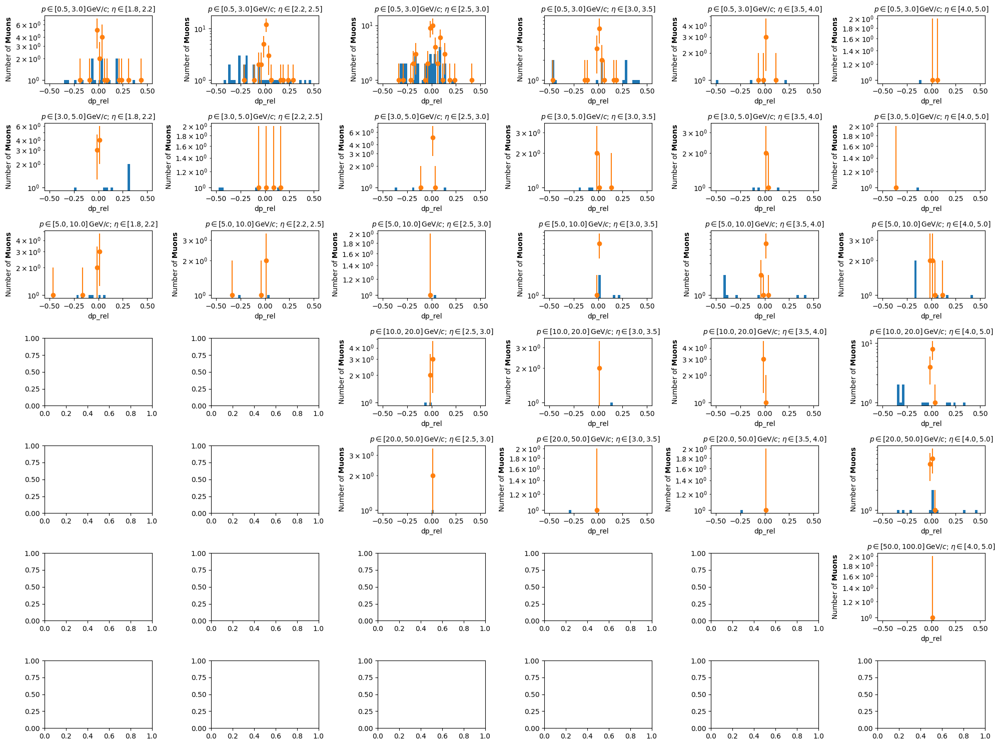

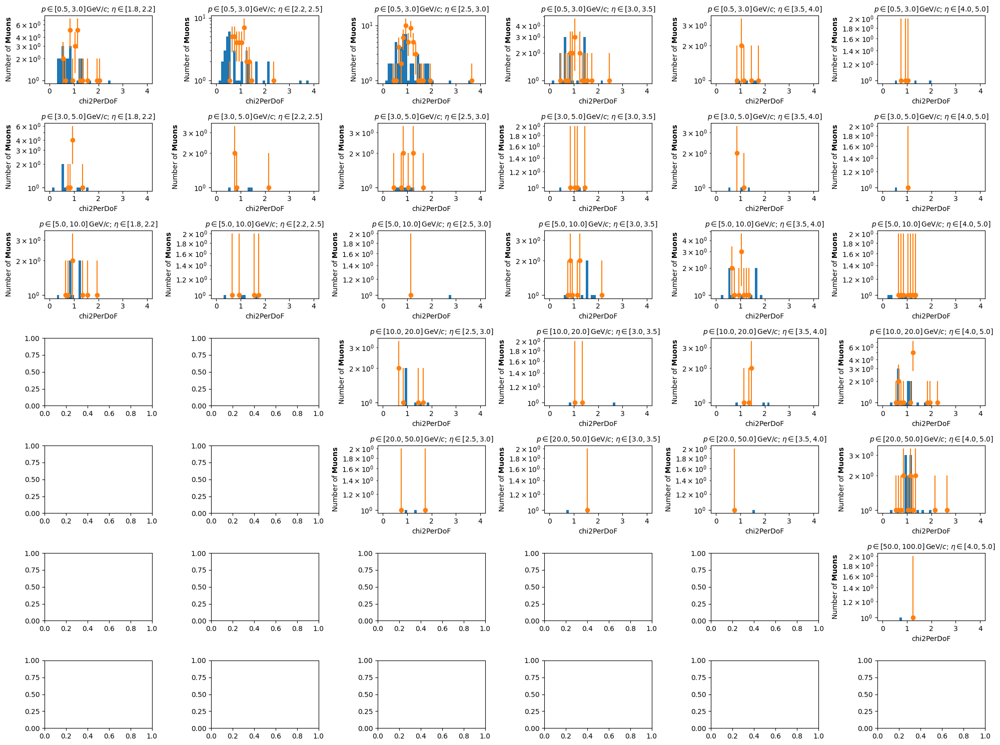

...

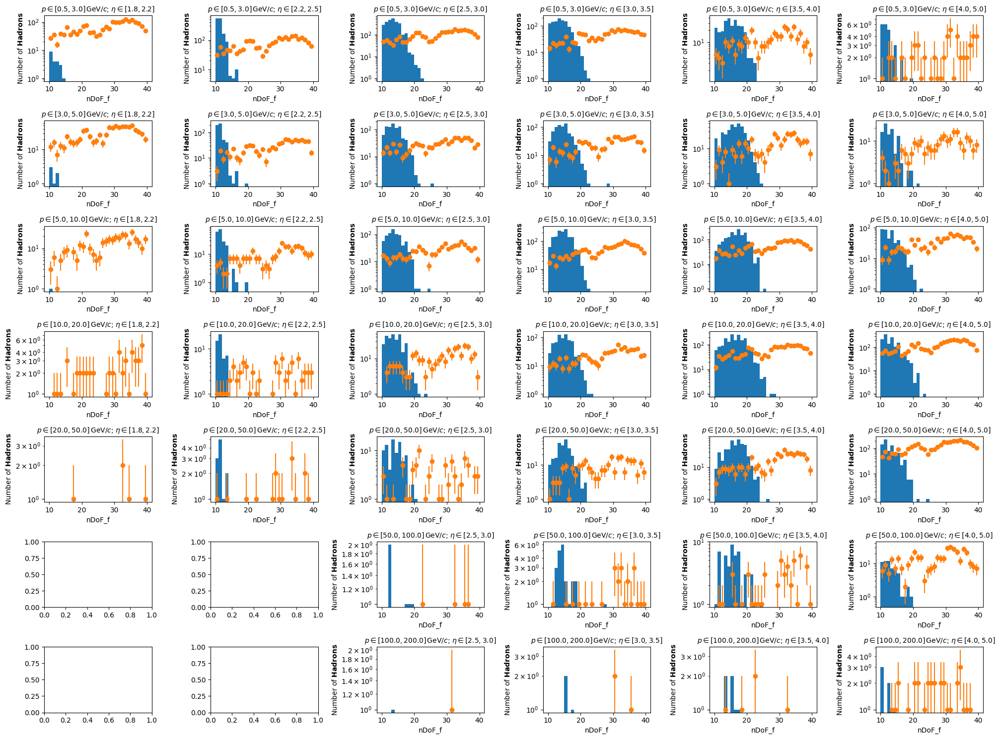

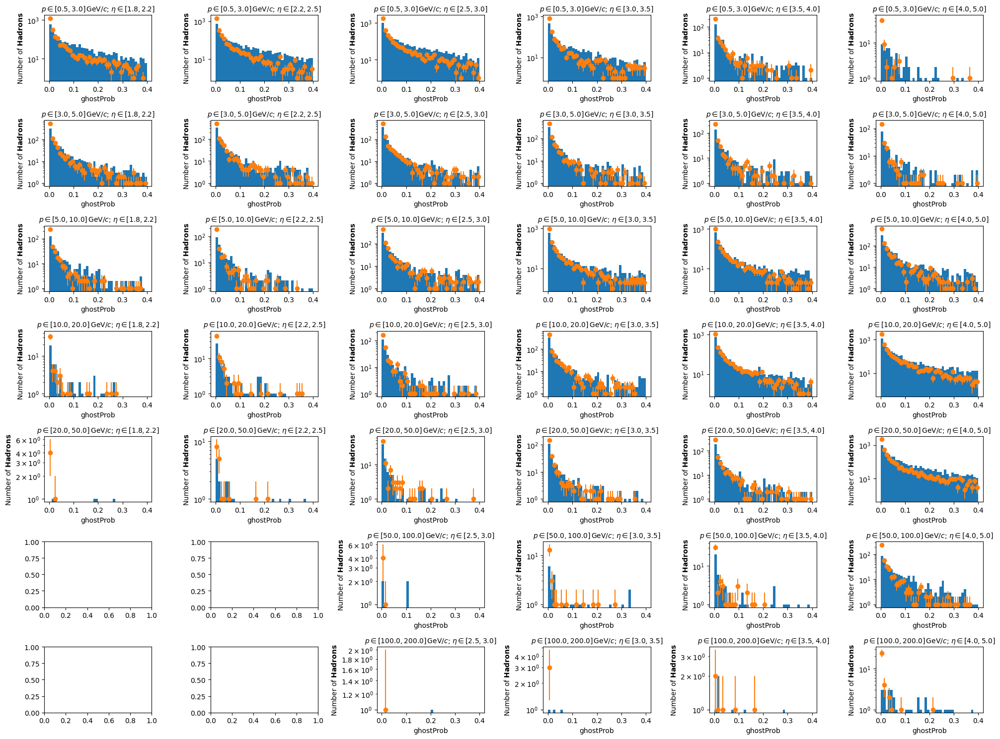

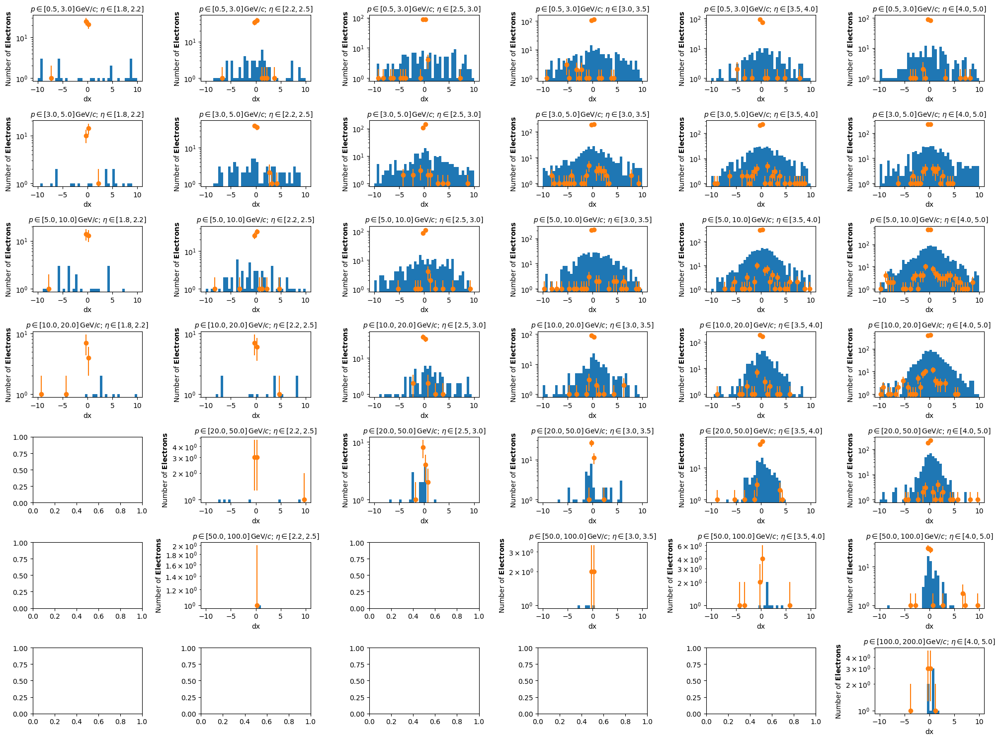

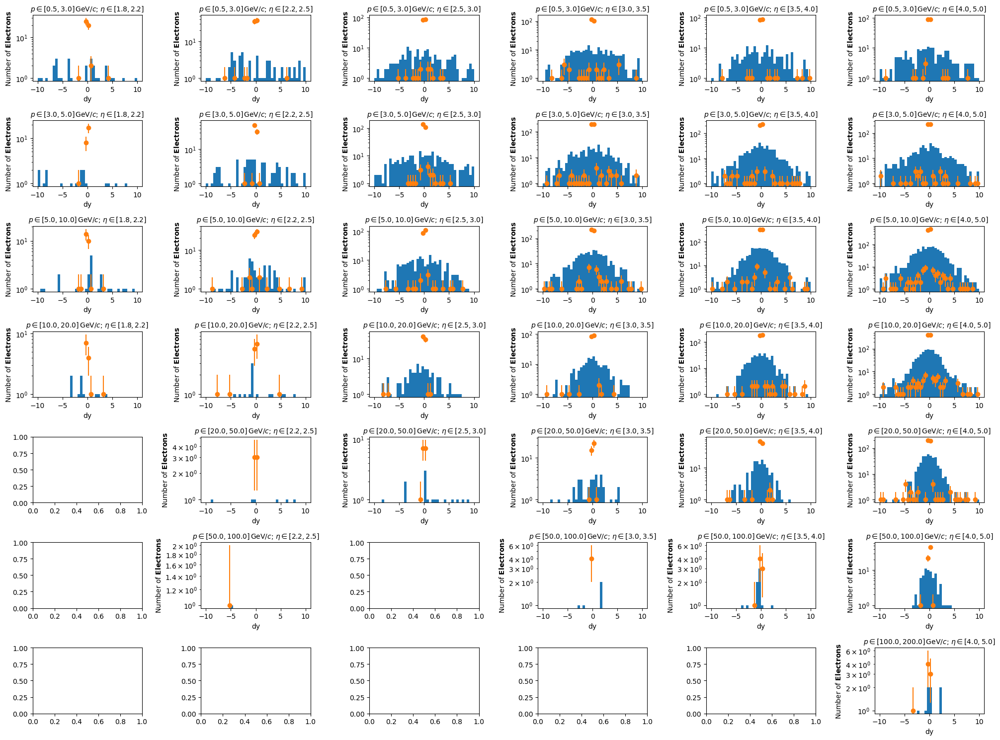

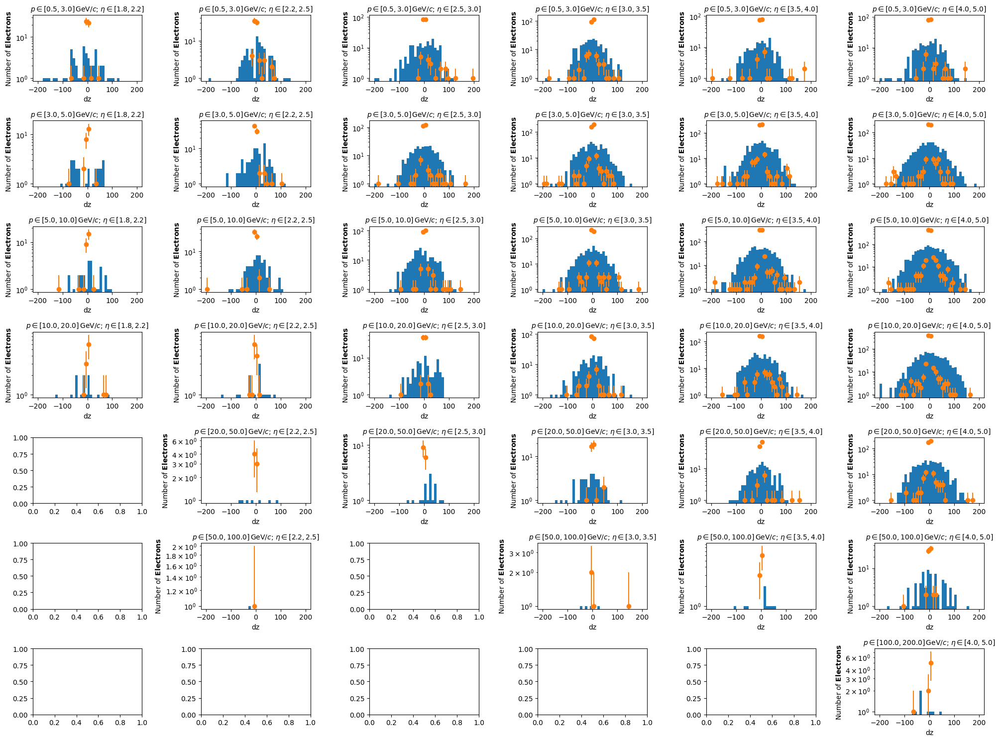

/tmp/ipykernel_27211/3998366271.py:50: RuntimeWarning: ks_2samp: Exact calculation unsuccessful. Switching to method=asymp.
  *ks_2samp(bin_df[label].values.get(), bin_df[f"predicted_{label}"].values.get())])


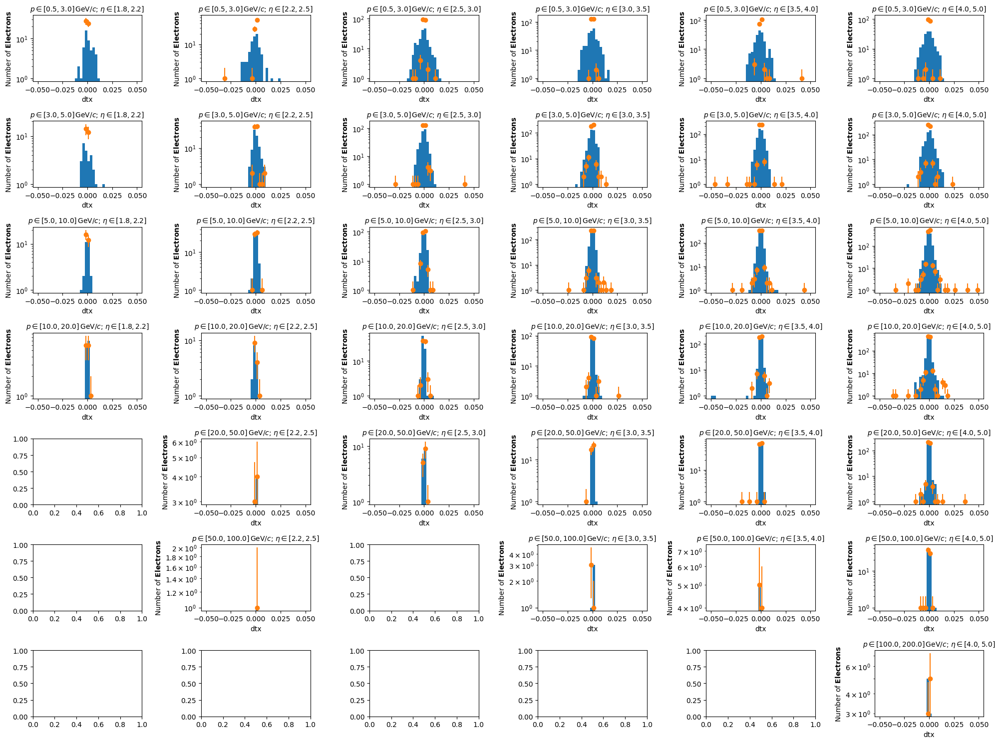

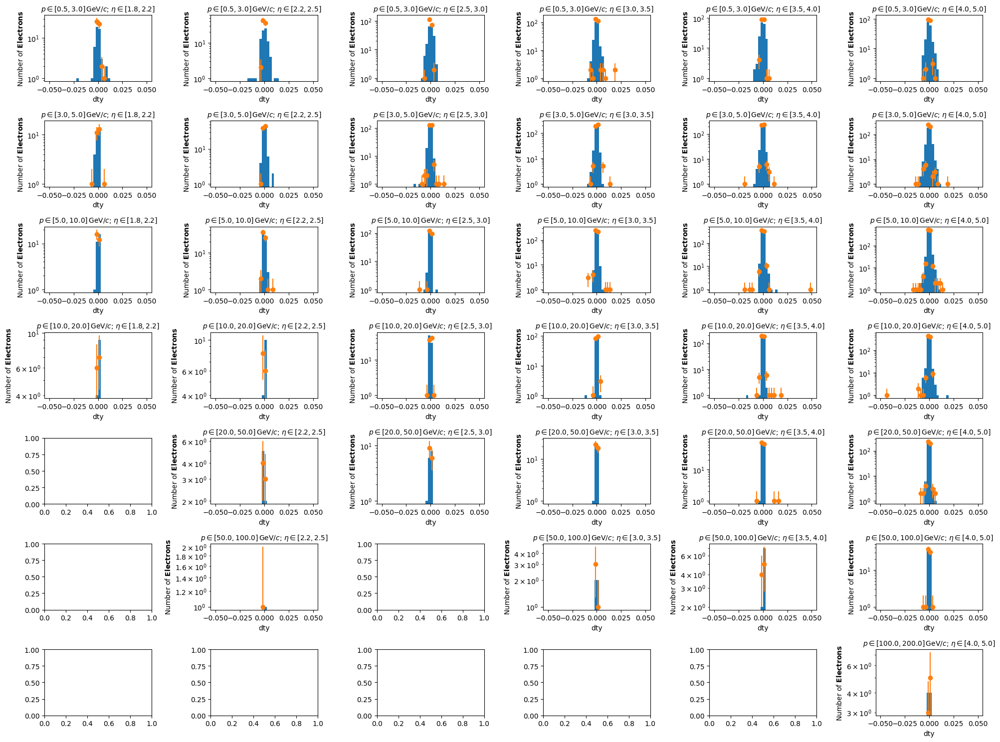

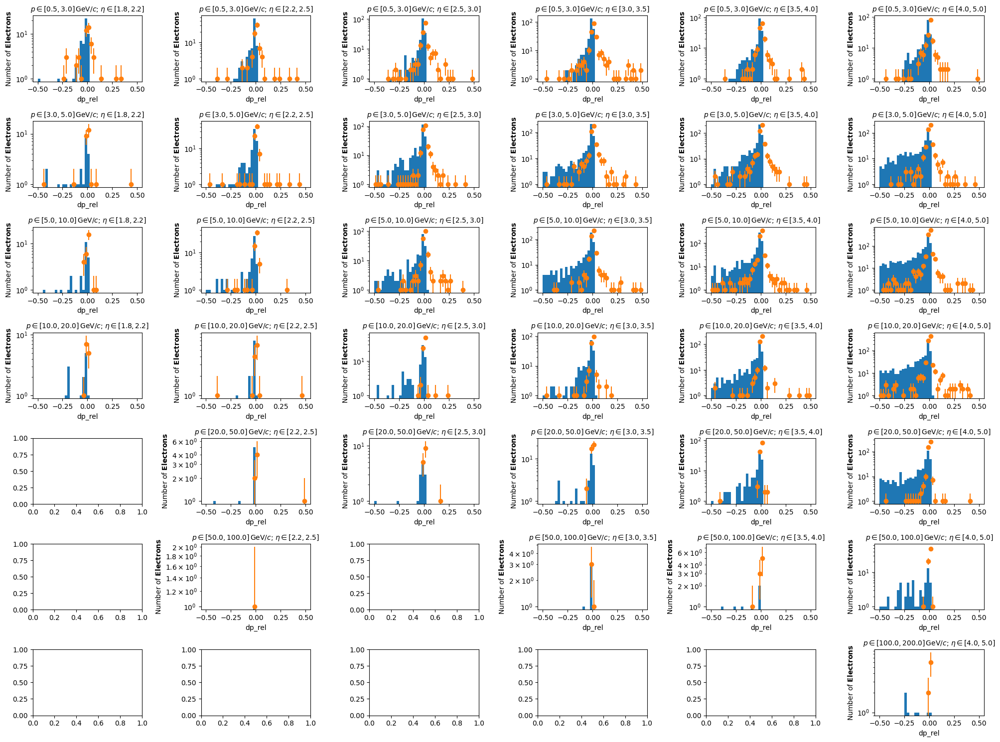

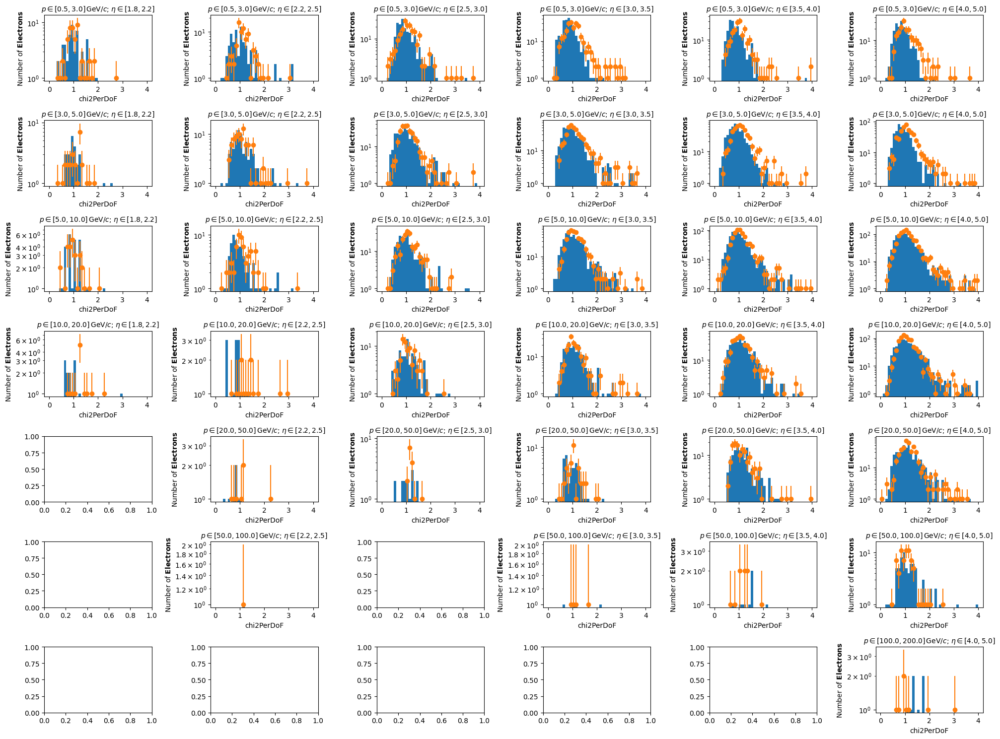

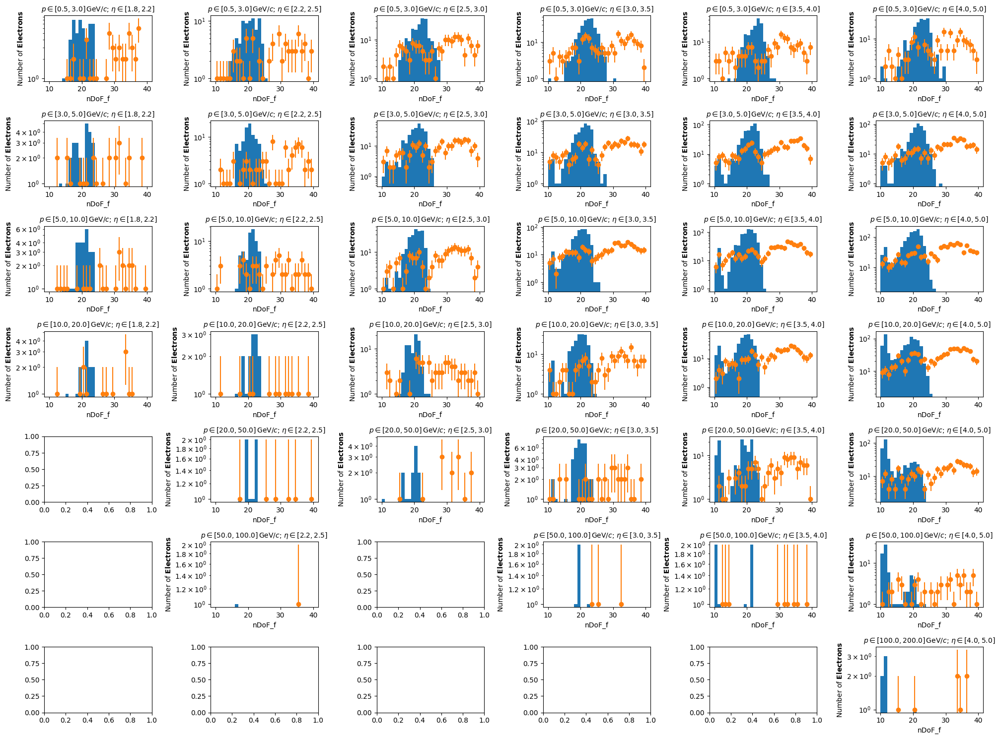

...

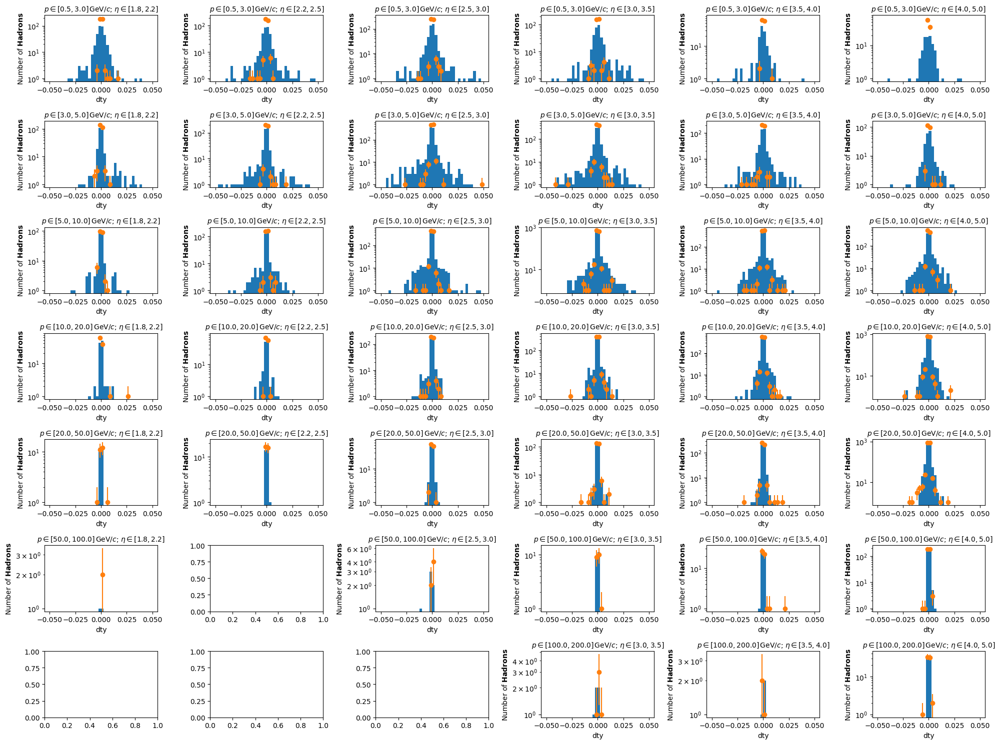

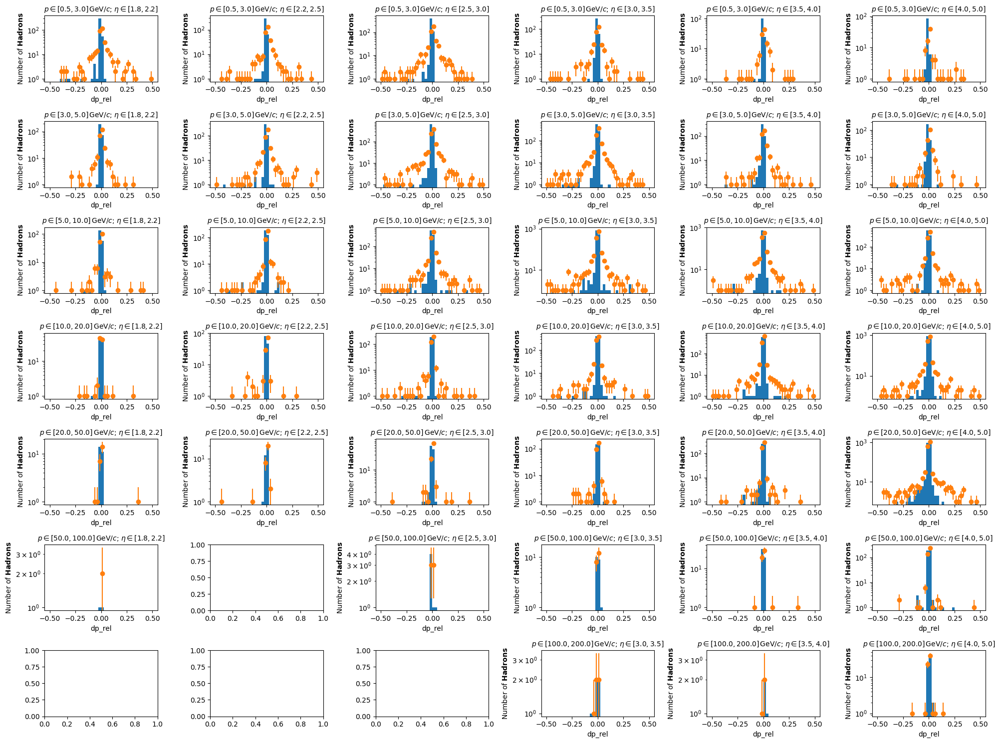

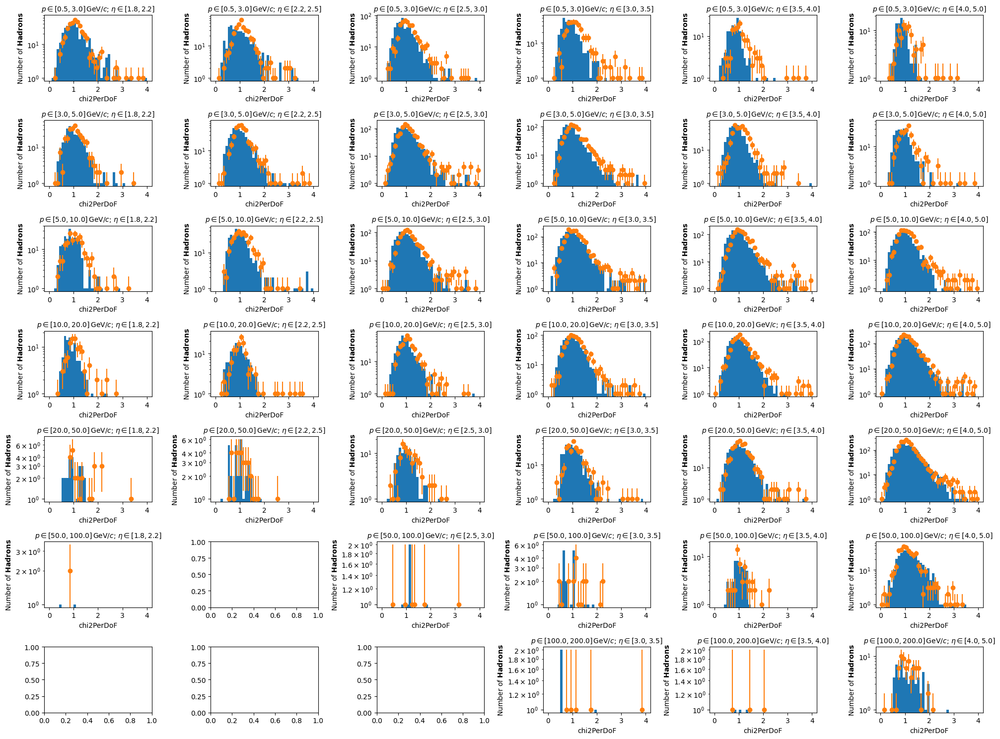

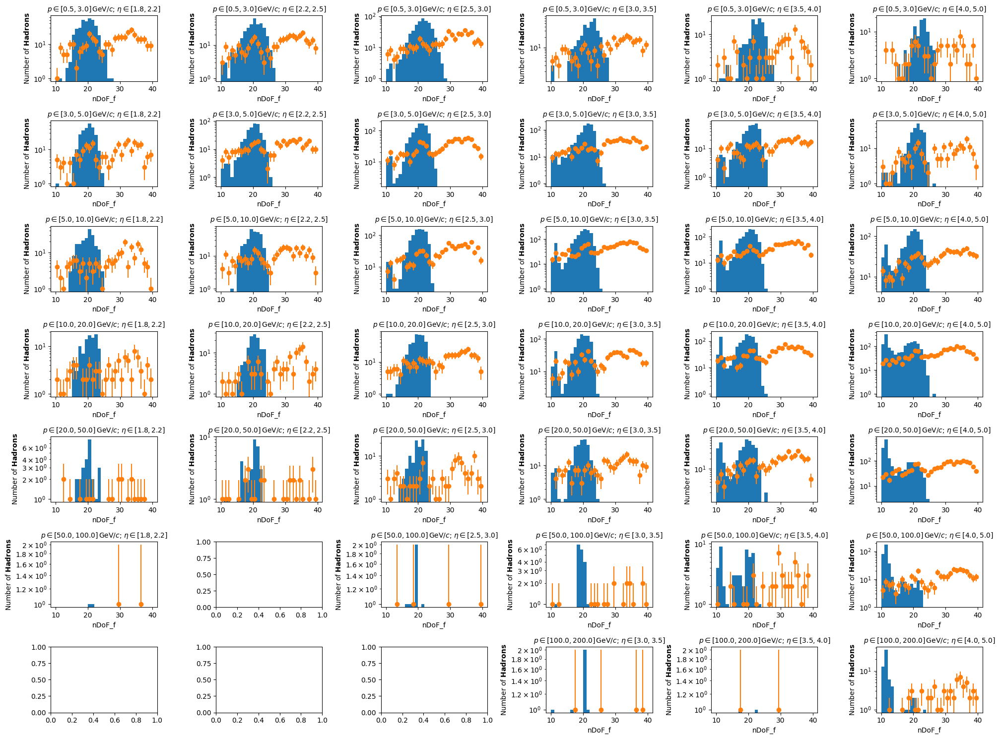

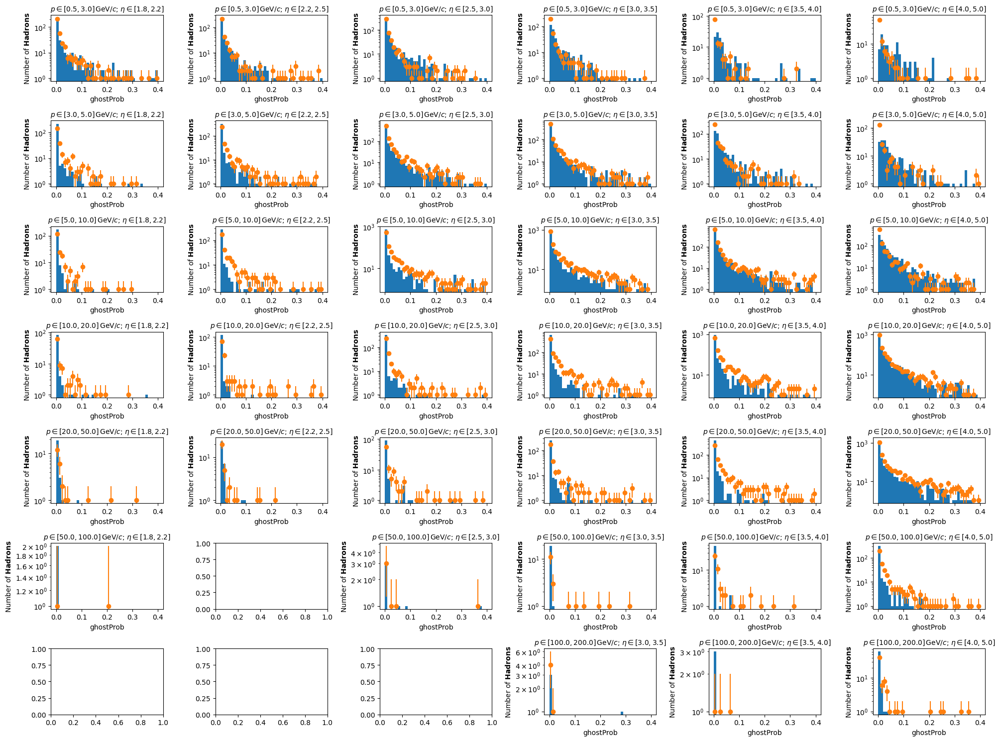

In [8]:
import matplotlib.pyplot as plt
from IPython.display import HTML
from scipy.stats import ks_2samp

track_types = ['long', 'upstream', 'downstream']
labels = data_reader.labels.copy()
labels[labels.index('dp')] = 'dp_rel'

parts = ['e', 'mu', 'h']
p_boundaries = [0.5, 3., 5., 10., 20., 50., 100., 200.]
eta_boundaries = [1.8, 2.2, 2.5, 3., 3.5, 4., 5.]

show_plots=True

ks_tests = []

for track_type in track_types:
    display(HTML(f"<H2>{track_type.capitalize()} tracks</H2>"))
    for part in parts:
        part_name = dict(h="hadron", e="electron", mu="muon")[part]
        display(HTML(f"<H3>Particle type: <U>{part_name}</U></H3>"))

        for label in labels:
            display(HTML(f"<H4>Variable: <FONT style='font-family: monospace; color: red;'>{label}</FONT> tracks</H4>"))

            plot_df = ccdf.query(f"{track_type}==1 and mc_is_{part} == 1")[["p_GeV", "mc_eta", label, f"predicted_{label}"]].compute()
            bins = binning_schemes.get(label, cp.linspace(plot_df[label].min(), plot_df[label].max(), 31))
            
            iPlot = 0
            if show_plots:
                plt.figure(figsize=(20,15))
                
            for p_min, p_max in zip(p_boundaries[:-1], p_boundaries[1:]):
                for eta_min, eta_max in zip(eta_boundaries[:-1], eta_boundaries[1:]):
                    iPlot += 1
                    if show_plots:
                        plt.subplot(len(p_boundaries)-1, len(eta_boundaries)-1, iPlot)
                        
                    bin_df = plot_df.query(f"p_GeV > {p_min} and p_GeV < {p_max} and mc_eta > {eta_min} and mc_eta < {eta_max}")
                    if len(bin_df)==0:
                        continue 
                        
                    h_true, _ = cp.histogram(bin_df[label].values, bins=bins)
                    h_pred, _ = cp.histogram(bin_df[f"predicted_{label}"].values, bins=bins)
                    
                    xAxis = 0.5*(bins[:-1] + bins[1:])
                    
                    ks_tests.append(
                        [track_type, part, label, p_min, p_max, eta_min, eta_max, len(bin_df),
                         *ks_2samp(bin_df[label].values.get(), bin_df[f"predicted_{label}"].values.get())])
                    
                    if show_plots:
                        plt.hist(xAxis.get(), bins.get(), weights=h_true.get(), label="Reference")
                        plt.errorbar(xAxis.get(), h_pred.get(), yerr=cp.sqrt(h_pred).get(), xerr=None, label="Model", fmt='o')

                        plt.xlabel(label)
                        plt.ylabel(f"Number of $\mathbf{{{part_name.capitalize()}s}}$")
                        plt.title(f"$p \in [{p_min:.1f}, {p_max:.1f}]\, \mathrm{{GeV}}/c$; $\eta \in [{eta_min:.1f}, {eta_max:.1f}]$",
                                 fontsize='medium') 
                        plt.yscale('log')

            if show_plots:
                plt.tight_layout()
                plt.show()
            #break
        #break
    #break
    
ks_tests = pd.DataFrame(
    ks_tests, 
    columns=[
        'track_type', 'part_type', 'variable', 'p_min', 'p_max', 'eta_min', 'eta_max', 
        'n_samples', 'ks_stat', 'p_value'])


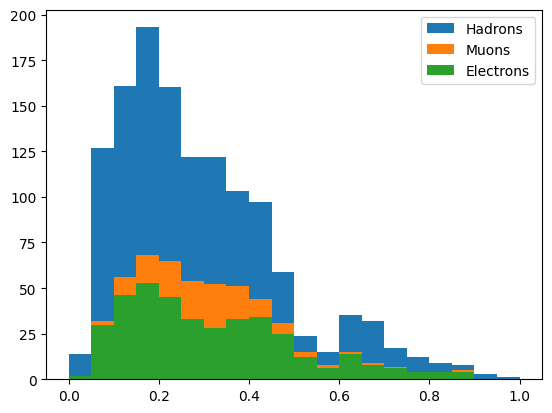

In [9]:
reliable_ks_tests = ks_tests.query("n_samples > 100")
plt.hist(reliable_ks_tests.ks_stat, bins=np.linspace(0,1,21), label="Hadrons")
plt.hist(reliable_ks_tests.query("part_type!='h'").ks_stat, bins=np.linspace(0,1,21), label="Muons")
plt.hist(reliable_ks_tests.query("part_type=='e'").ks_stat, bins=np.linspace(0,1,21), label="Electrons")
plt.legend()
plt.show()

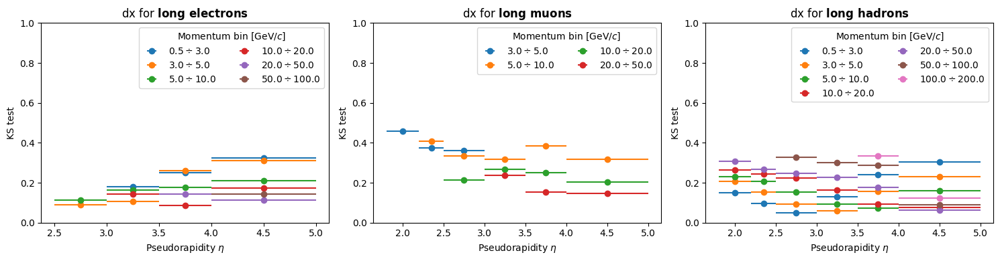

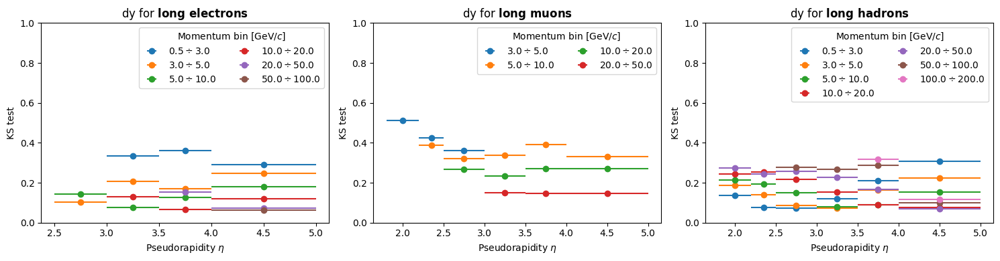

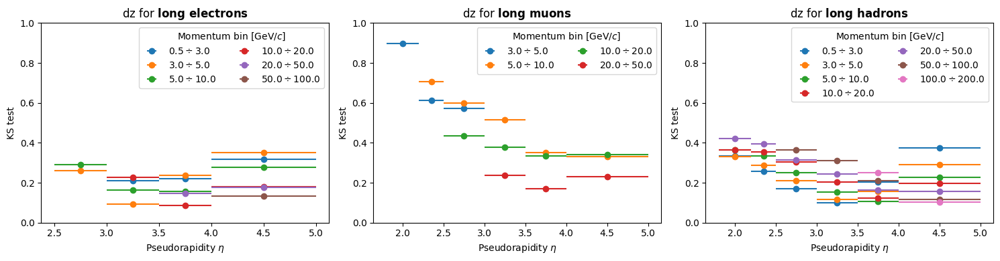

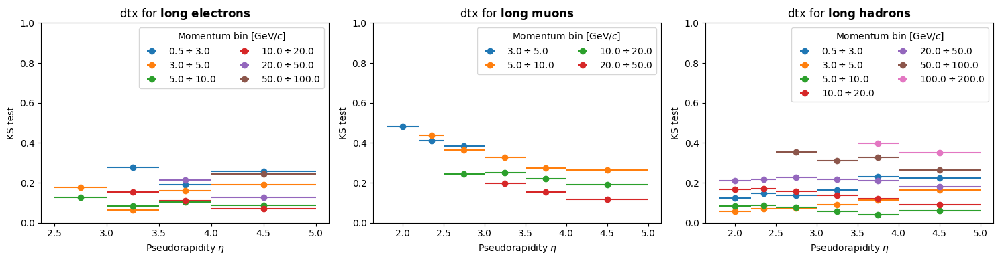

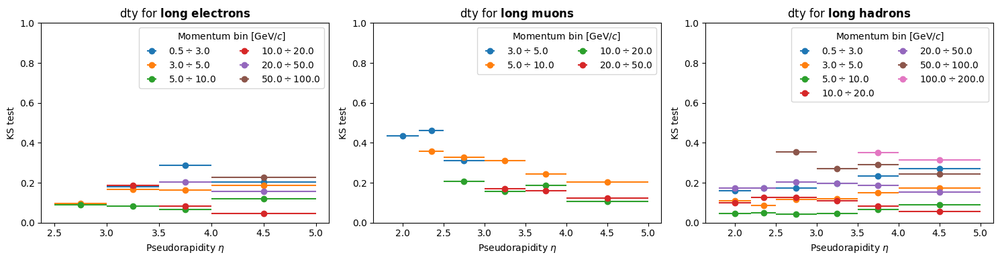

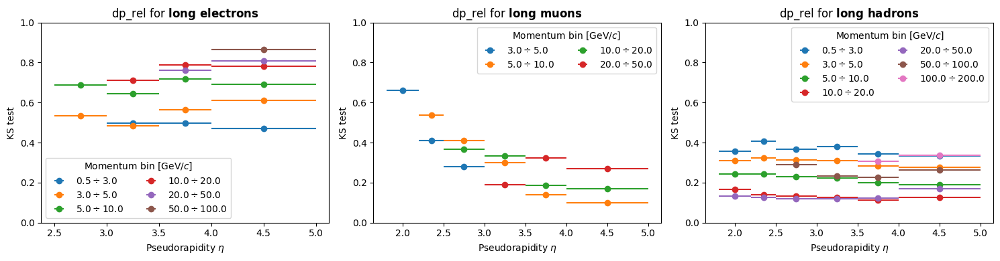

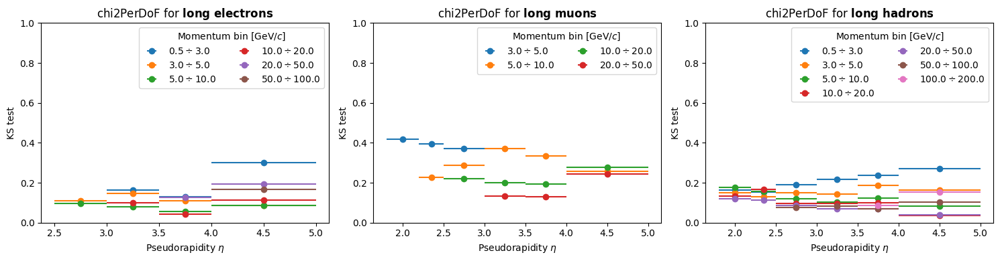

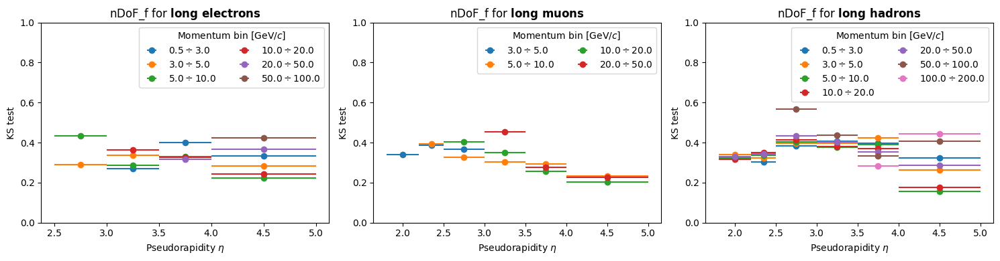

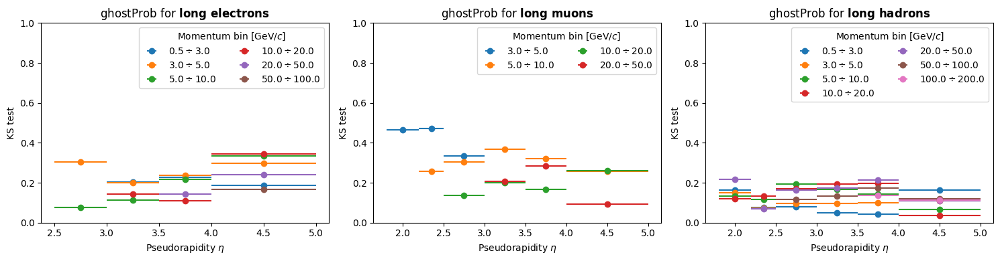

No handles with labels found to put in legend.


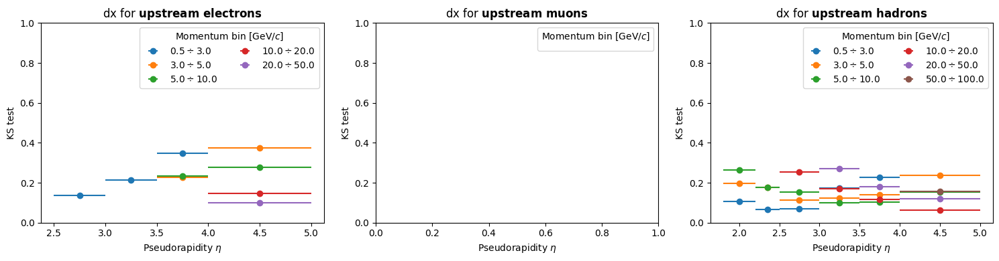

No handles with labels found to put in legend.


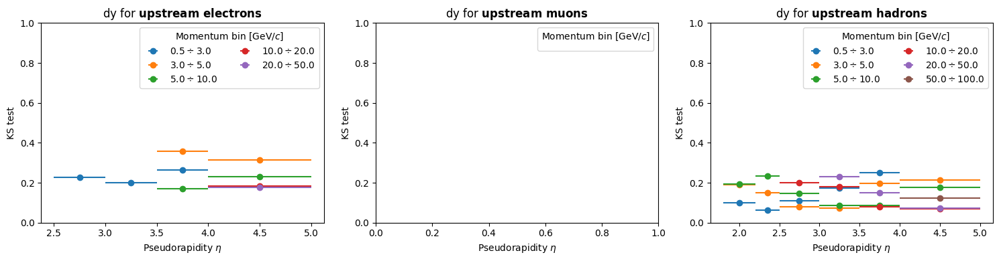

No handles with labels found to put in legend.


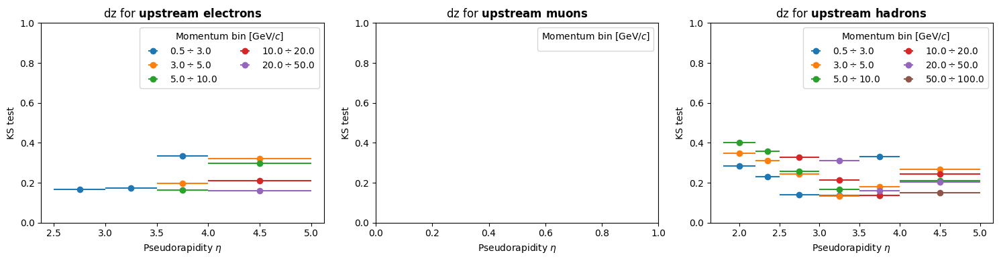

No handles with labels found to put in legend.


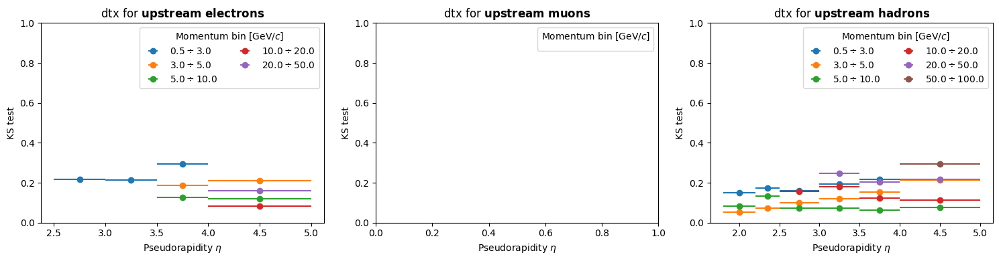

No handles with labels found to put in legend.


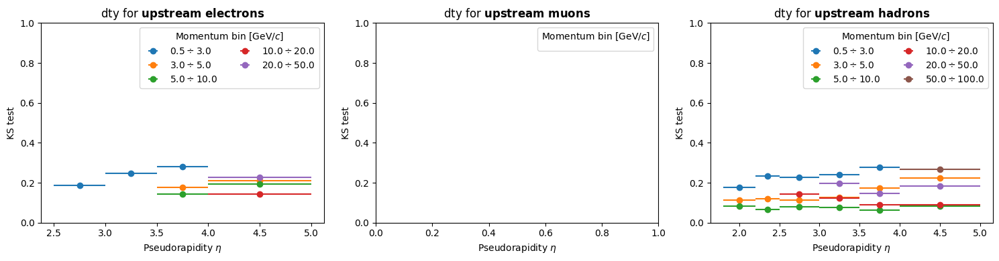

No handles with labels found to put in legend.


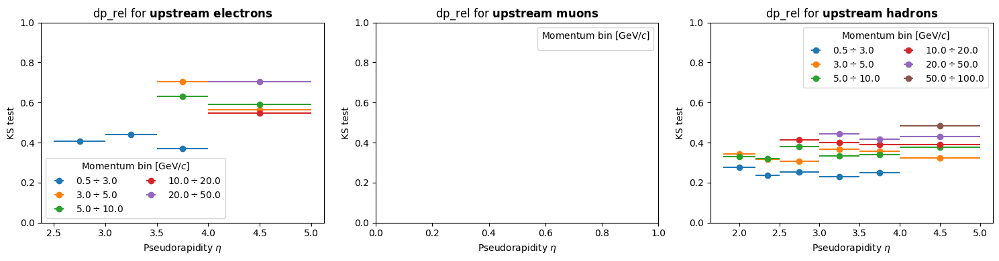

No handles with labels found to put in legend.


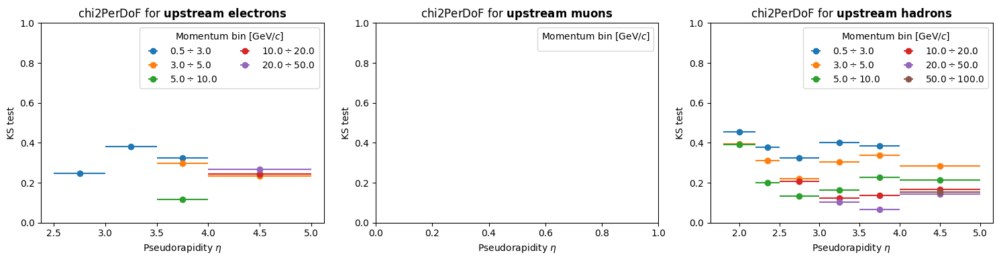

No handles with labels found to put in legend.


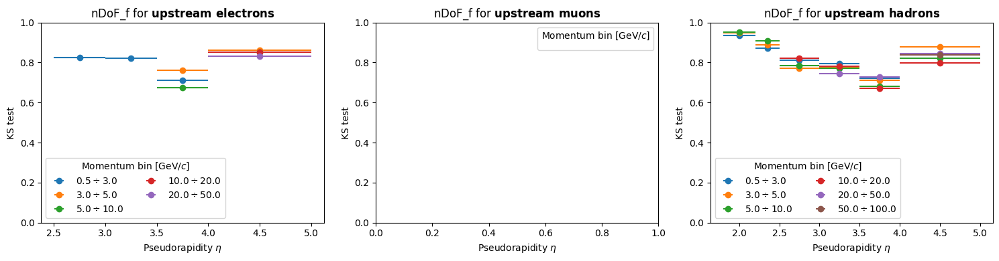

No handles with labels found to put in legend.


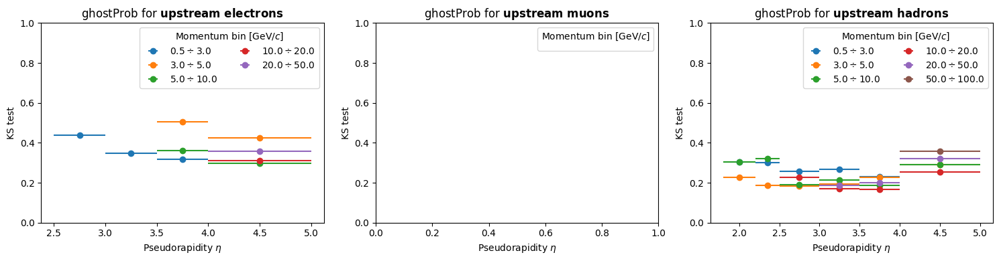

No handles with labels found to put in legend.


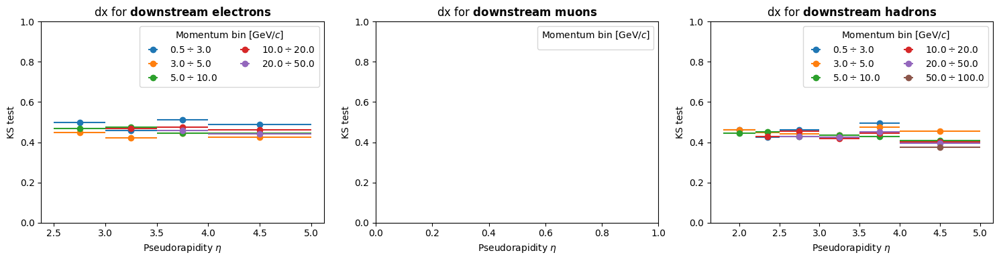

No handles with labels found to put in legend.


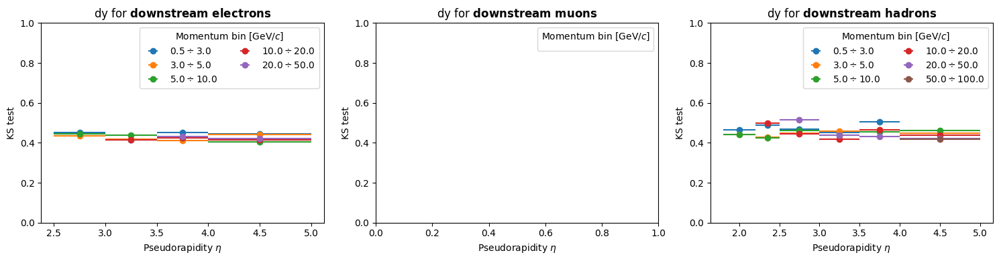

No handles with labels found to put in legend.


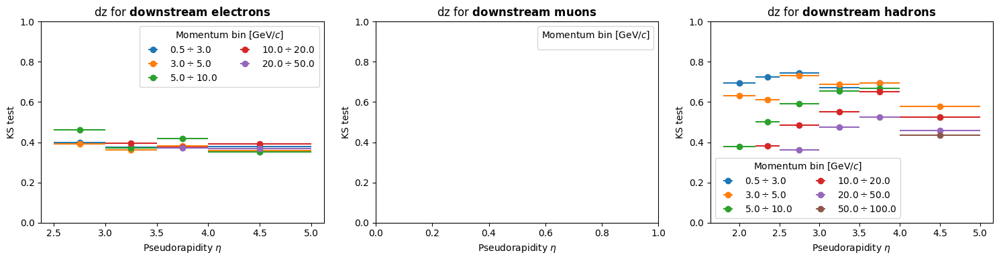

No handles with labels found to put in legend.


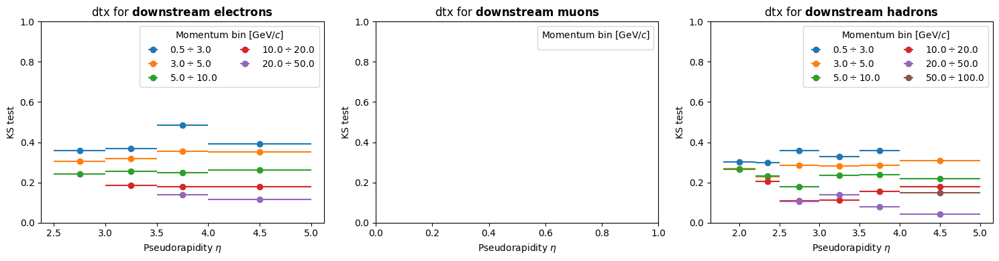

No handles with labels found to put in legend.


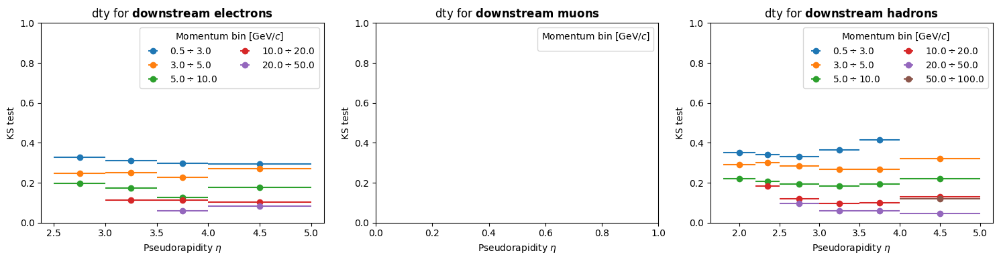

No handles with labels found to put in legend.


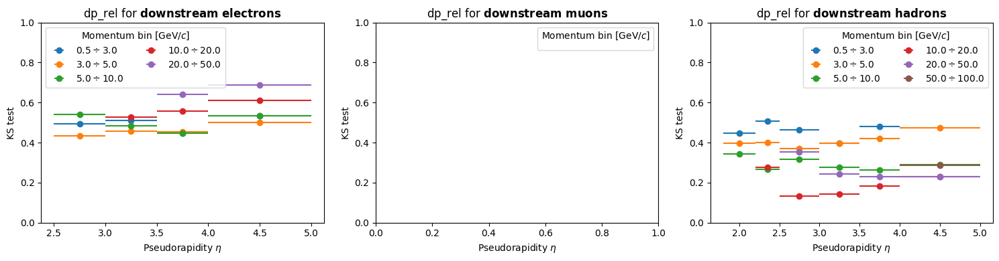

No handles with labels found to put in legend.


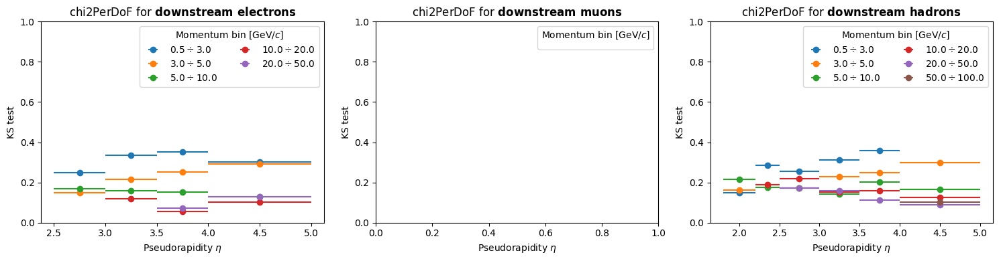

No handles with labels found to put in legend.


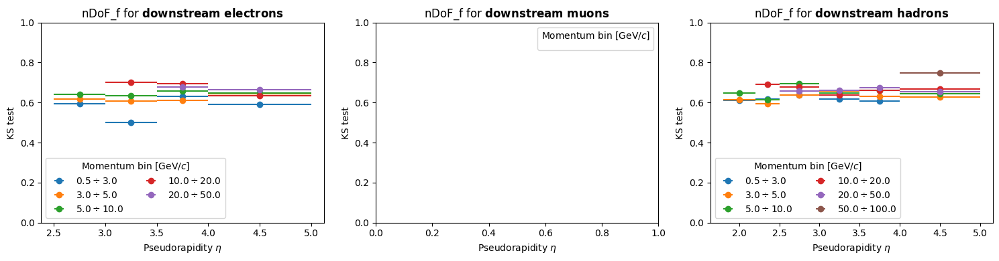

No handles with labels found to put in legend.


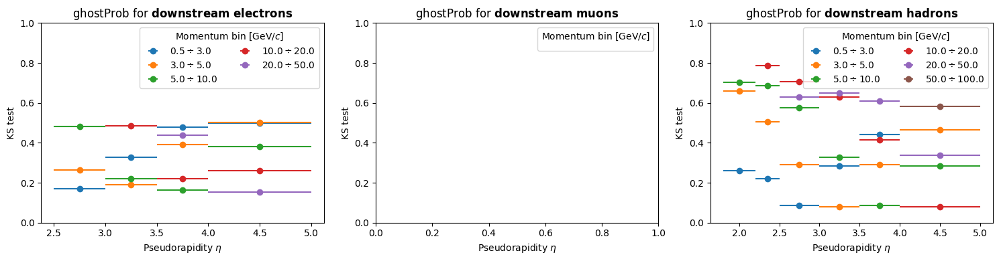

In [10]:
for track_type in track_types:
    for label in labels:
        plt.figure(figsize=(15, 4))
        for iPlot, part_type in enumerate(parts, 1):            
            part_name = dict(h="hadron", e="electron", mu="muon")[part_type]
            plt.subplot(1, 3, iPlot)

            bin_ks = reliable_ks_tests.query(f"track_type=='{track_type}' and part_type=='{part_type}' and variable=='{label}'")
            #display(bin_ks)
            
            for (p_min, p_max), df in bin_ks.groupby(['p_min', 'p_max']):
                xAxis = (df.eta_min + df.eta_max)/2
                plt.errorbar(xAxis, df.ks_stat, xerr=np.c_[xAxis - df.eta_min, df.eta_max - xAxis].T, yerr=None, 
                             fmt='o', label=f"${p_min:.1f} \div {p_max:.1f}$")
            plt.legend(title="Momentum bin [GeV/$c$]", ncol=2)
            plt.xlabel("Pseudorapidity $\eta$")
            plt.ylabel("KS test")
            plt.title(f"{label} for $\mathbf{{{track_type}\ {part_name}s}}$")
            plt.ylim(0,1)
        plt.tight_layout()
        plt.show()